In [3]:
import pickle# load the model from disk
import numpy as np
import pandas as pd
import cv2 as cv

from matplotlib.image import imread
import matplotlib.pyplot as plt

import os
from os import listdir
from os.path import isfile, join
dir = os.path.dirname

import PIL
import PIL.Image
import tensorflow as tf
from tensorflow import keras

# importación de librerías propias
import utils.sql_tb as sql
import utils.models as md
import utils.folders_tb as fld
from utils import tools
from utils.mysql_driver import MySQL
import utils.mysql_driver as drv

# generación del set de test
batch_size = 32   # tamaño de los conjuntos de entrenamiento que se le pasan al modelo para que no aprenda todo de golpe y no se bloquee.
img_height = 144
img_width = 144
flag_first_exec = 0
signs = ['no_speed', 'speed100', 'speed120', 'speed20', 'speed30', 'speed50', 'speed60', 'speed70', 'speed80']

### CARGA DE LOS MODELOS SOLO EN LA PRIMERA EJECUCIÓN ####
# MODELO OPCIÓN 0 ###
model_vgg16_signs0 = keras.models.load_model('../models/model_vgg16_signs0.h5')

# MODELO OPCIÓN 1 ###
model_vgg16_class1 = keras.models.load_model('../models/model_vgg16_class1.h5')
model_vgg16_signs1 = keras.models.load_model('../models/model_vgg16_signs1.h5')

# MODELO OPCIÓN 2 ###
model_vgg16_class2 = keras.models.load_model('../models/model_vgg16_class2.h5')
model_vgg16_signs2 = keras.models.load_model('../models/model_vgg16_signs2.h5')

# elección de los elementos a analizar
class_to_analyze = ['test', 'speed_test', 'real'] 

### creación de la lista donde quedarán registradas las predicciones
sql_list = []

for j in range(len(class_to_analyze)):

    # enrutado a las distintas carpetas que se han usado en el proyecto
    if class_to_analyze[j] == 'test':
        relative_path = os.sep + 'data' + os.sep + 'data_test'  # predicción de una parte de las imágenes de Test (100)
    elif class_to_analyze[j] == 'speed_test':
        relative_path = os.sep + 'data' + os.sep + 'data_speed_test'  # predicción de una parte de las imágenes de Test específicas de velocidad (100)
    elif class_to_analyze[j] == 'real':
        relative_path = os.sep + 'data' + os.sep + 'data_entorno_real'  # predicción de imágenes de entorno real

    # acceso a la carpeta activada
    data_path = dir (os.getcwd()) + relative_path                    

    # llamada a la función para obtener la lista de imágenes a procesar
    img_list, only_image_names = fld.get_img_array_from_dir(data_path,img_height, img_width)

    ### PREDICCIONES ####
    # Variables de predicción de señal (tanto final como cada modelo)
    Y_pred,Y_pred_mod0,Y_pred_mod1,Y_pred_mod2 = md.voting3_pred (img_list,img_height, img_width, model_vgg16_signs0, model_vgg16_class1, model_vgg16_signs1, model_vgg16_class2, model_vgg16_signs2)

    ### creación de la línea del dataframe
    for i in range(len(Y_pred)):
        sql_list.append([only_image_names[i], class_to_analyze[j], signs[Y_pred_mod0[i]], signs[Y_pred_mod1[i]], signs[Y_pred_mod2[i]], signs[tools.most_frequent(Y_pred[i])]])

# SQL
sql_columns = ['pic_name', 'class', 'pred_m0', 'pred_m1', 'pred_m2', 'pred_model']
sql_out_cols = ['id', 'timestamp','pic_name', 'class', 'pred_m0', 'pred_m1', 'pred_m2', 'pred_model']

# creación del dataframe que se va a subir a la BBDD
df_sql = pd.DataFrame(sql_list, columns=sql_columns)
sql.insert_sqlList (df_sql)

Connected to MySQL server [05290575t_ds_april_2021_db]
Executed 

DROP TABLE IF EXISTS miguel_barquero_delpozo

 successfully
Executed 

CREATE TABLE miguel_barquero_delpozo(
        ID INT(11) NOT NULL AUTO_INCREMENT,
        MOMENTO TIMESTAMP NOT NULL,
        PIC_NAME VARCHAR(255) NOT NULL,CLASS VARCHAR(255) NOT NULL,PRED_M0 VARCHAR(255) NOT NULL,PRED_M1 VARCHAR(255) NOT NULL,PRED_M2 VARCHAR(255) NOT NULL,PRED_MODEL VARCHAR(255) NOT NULL,
        PRIMARY KEY (ID))

 successfully
Executed 

INSERT INTO miguel_barquero_delpozo 
        (MOMENTO,PIC_NAME,CLASS,PRED_M0,PRED_M1,PRED_M2,PRED_MODEL)
                    VALUES 
        (NOW(), '00000.png', 'test', 'no_speed', 'no_speed', 'no_speed', 'no_speed')

 successfully
Executed 

INSERT INTO miguel_barquero_delpozo 
        (MOMENTO,PIC_NAME,CLASS,PRED_M0,PRED_M1,PRED_M2,PRED_MODEL)
                    VALUES 
        (NOW(), '00001.png', 'test', 'speed50', 'speed30', 'speed30', 'speed30')

 successfully
Executed 

INSERT INTO miguel

In [4]:
df_sql = sql.get_data_sql(sql_out_cols)
df_sql

Connected to MySQL server [05290575t_ds_april_2021_db]
Executing:
 SELECT * FROM miguel_barquero_delpozo
Close connection with MySQL server [05290575t_ds_april_2021_db]


,id,timestamp,pic_name,class,pred_m0,pred_m1,pred_m2,pred_model
0,1,2021-07-09 17:58:04,00000.png,test,no_speed,no_speed,no_speed,no_speed
1,2,2021-07-09 17:58:04,00001.png,test,speed50,speed30,speed30,speed30
2,3,2021-07-09 17:58:04,00002.png,test,no_speed,no_speed,no_speed,no_speed
3,4,2021-07-09 17:58:04,00003.png,test,no_speed,no_speed,no_speed,no_speed
4,5,2021-07-09 17:58:04,00004.png,test,no_speed,no_speed,no_speed,no_speed
...,...,...,...,...,...,...,...,...
173,174,2021-07-09 17:58:09,carpic_5.bmp,real,no_speed,speed50,no_speed,no_speed
174,175,2021-07-09 17:58:09,carpic_5.png,real,no_speed,no_speed,no_speed,no_speed
175,176,2021-07-09 17:58:09,carpic_6.png,real,speed100,speed100,speed100,speed100
176,177,2021-07-09 17:58:09,carpic_7.png,real,no_speed,speed100,speed100,speed100


# Visualización de predicciones

### Primero se comprueban los aciertos del modelo a la hora de diferenciar señales de velocidad del resto de señales con imagenes del conjunto de test

### A continuación se analiza la efectividad de los modelos para distinguir la velocidad indicada en las señales de velocidad con imágenes de test

### Por último, se analiza la efectividad del modelo combinado para identificar las señales dentro de imágenes de un entorno real

In [7]:
booster = 0

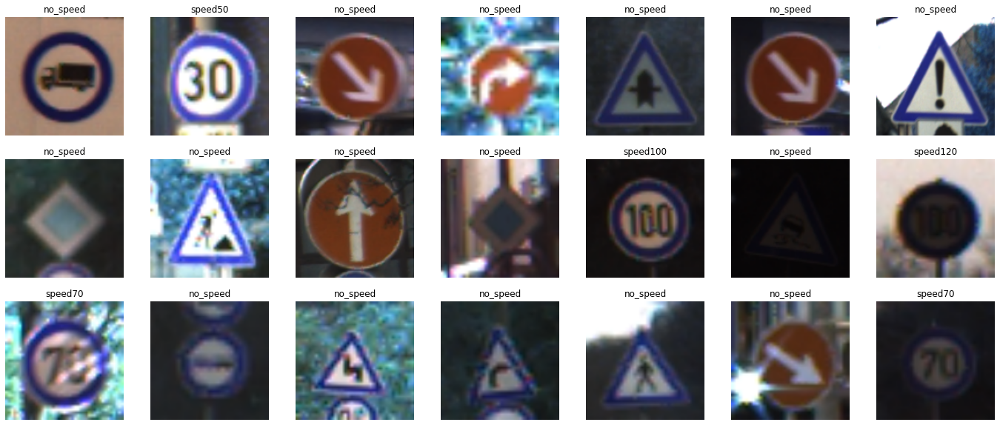

In [14]:
plt.figure(figsize=(24, 10))
for i in range(21):
    ax = plt.subplot(3, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[Y_pred_mod0[i+booster]])
    plt.axis("off")
    plt.savefig('../reports/test_model0.png')

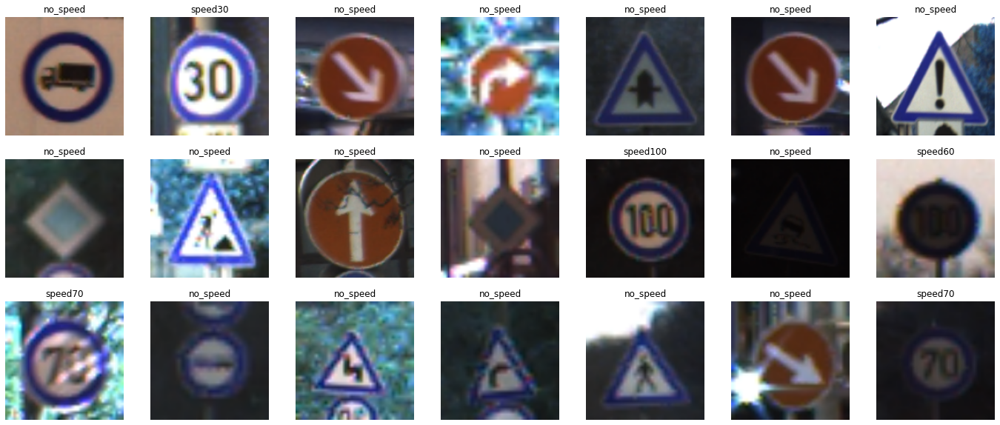

In [15]:
plt.figure(figsize=(24, 10))
for i in range(21):
    ax = plt.subplot(3, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[Y_pred_mod1[i+booster]])
    plt.axis("off")
    plt.savefig('../reports/test_model1.png')

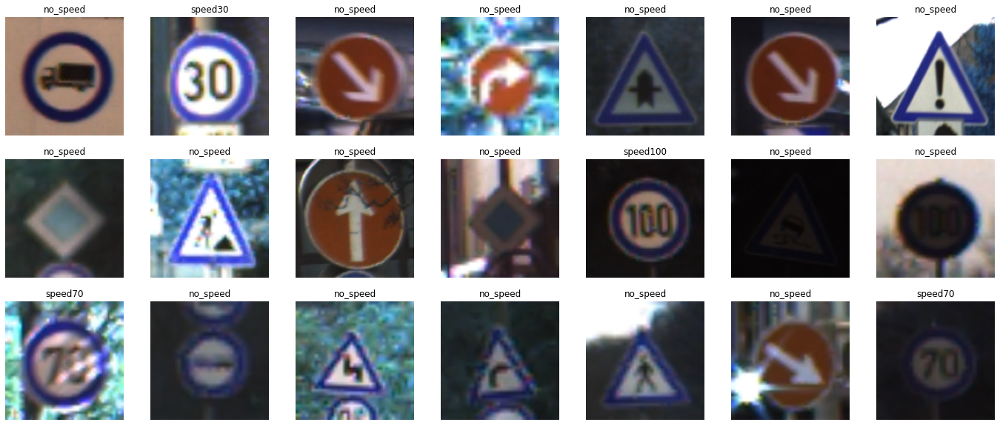

In [16]:
plt.figure(figsize=(24, 10))
for i in range(21):
    ax = plt.subplot(3, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[Y_pred_mod2[i+booster]])
    plt.axis("off")
    plt.savefig('../reports/test_model2.png')

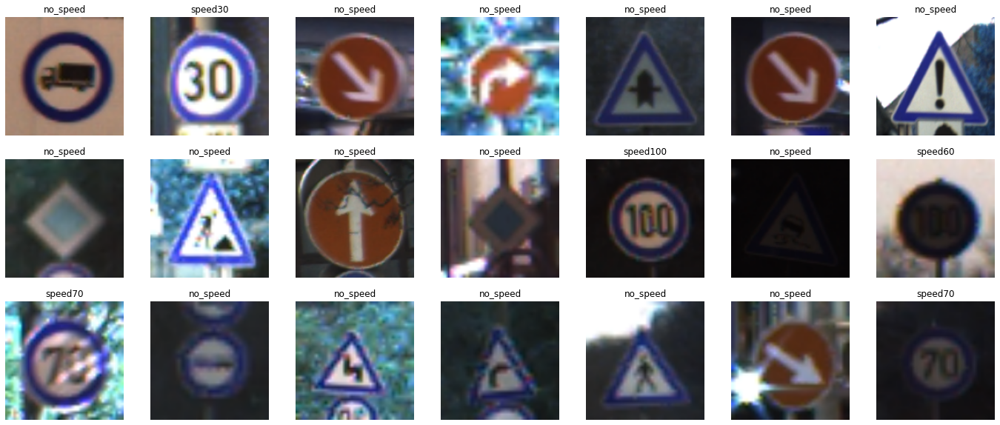

In [17]:
plt.figure(figsize=(24, 10))
for i in range(21):
    ax = plt.subplot(3, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[tools.most_frequent(Y_pred[i+booster])])
    plt.axis("off")
    plt.savefig('../reports/test_model.png')

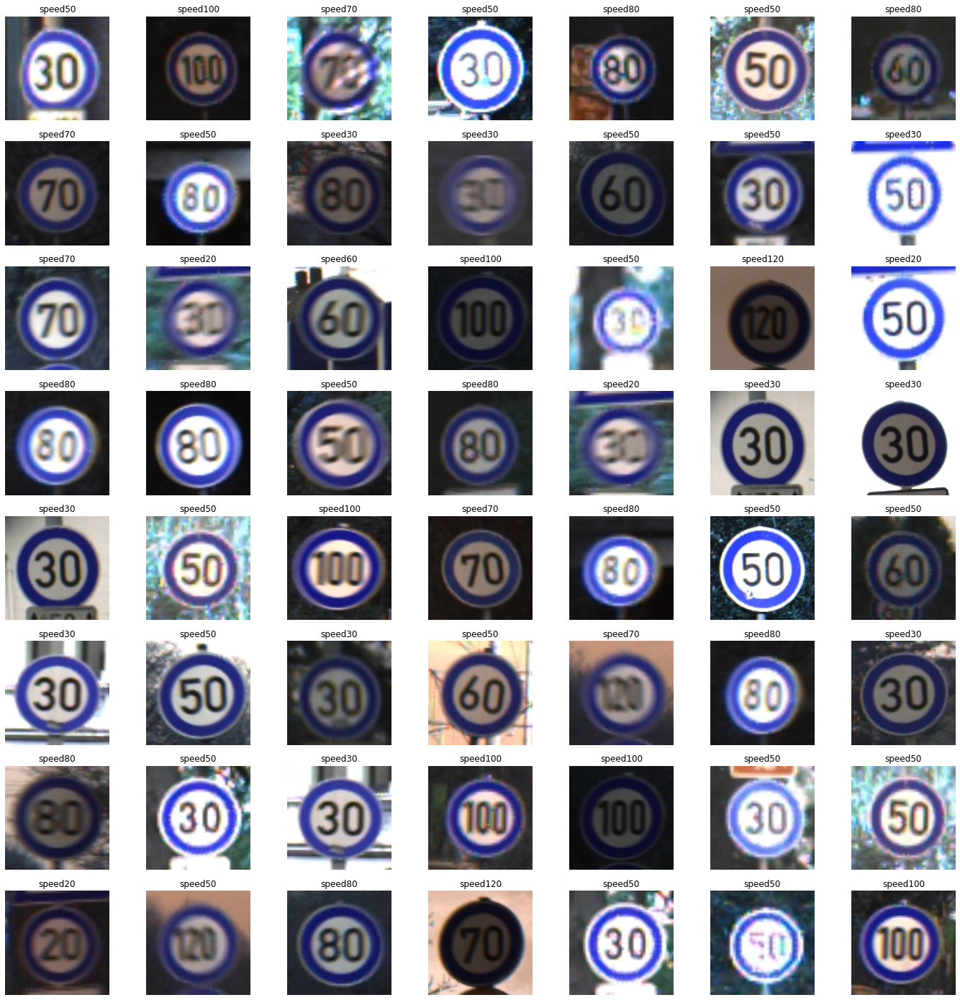

In [35]:
plt.figure(figsize=(24, 25))
for i in range(56):
    ax = plt.subplot(8, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[Y_pred_mod0[i+booster]])
    plt.axis("off")
    plt.savefig('../reports/speed_model0.png')

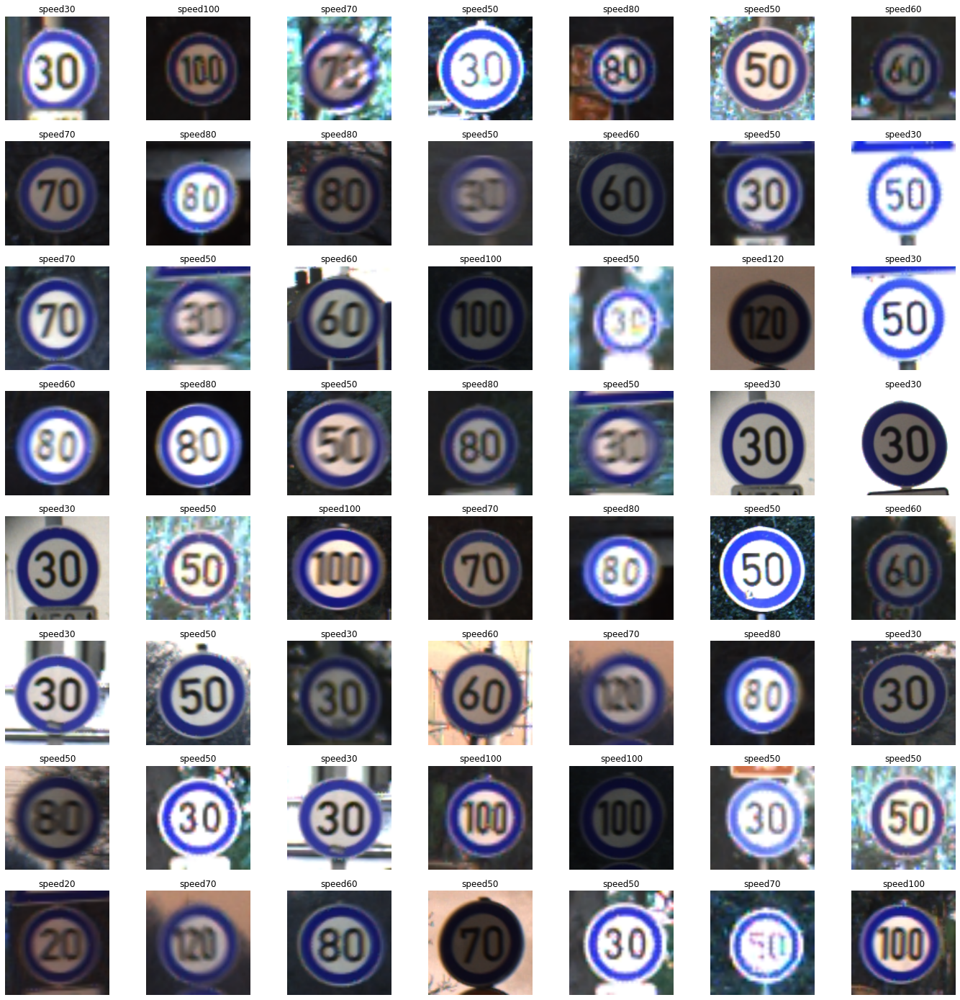

In [39]:
plt.figure(figsize=(24, 25))
for i in range(56):
    ax = plt.subplot(8, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[Y_pred_mod1[i+booster]])
    plt.axis("off")
    plt.savefig('../reports/speed_model1.png')

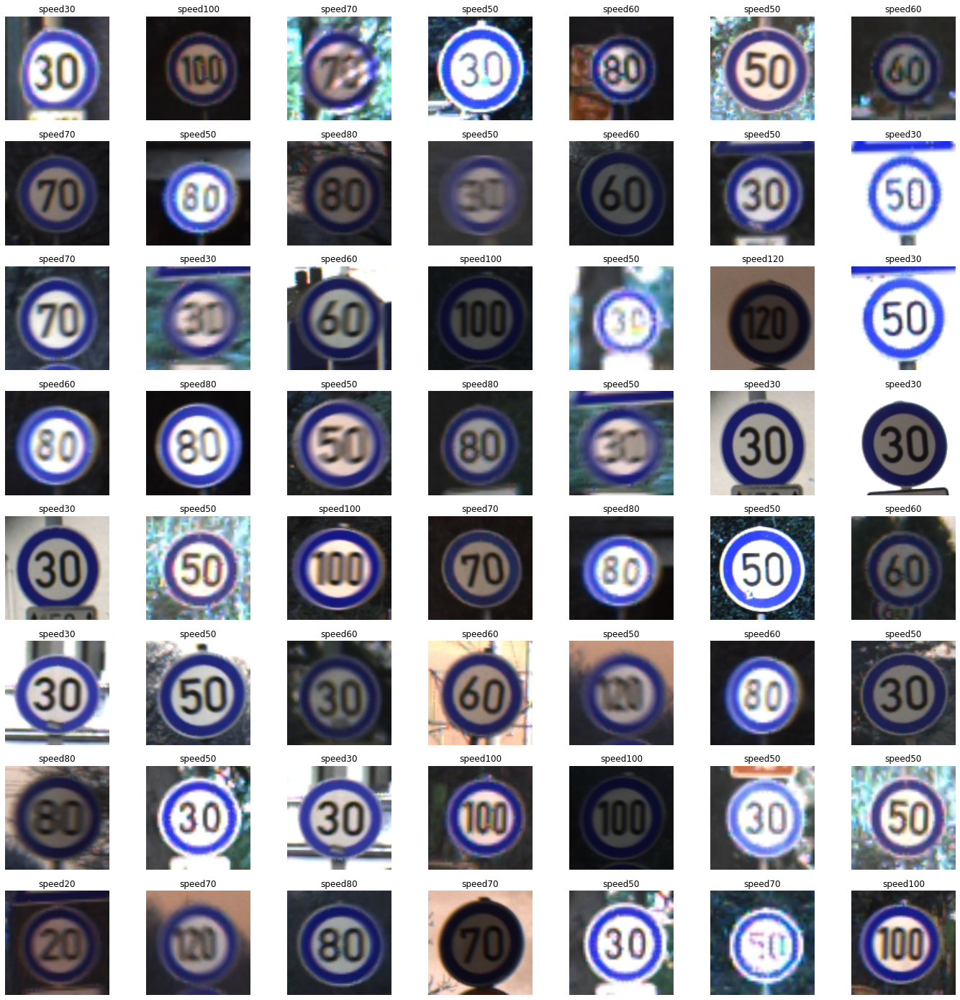

In [40]:
plt.figure(figsize=(24, 25))
for i in range(56):
    ax = plt.subplot(8, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[Y_pred_mod2[i+booster]])
    plt.axis("off")
    plt.savefig('../reports/speed_model2.png')

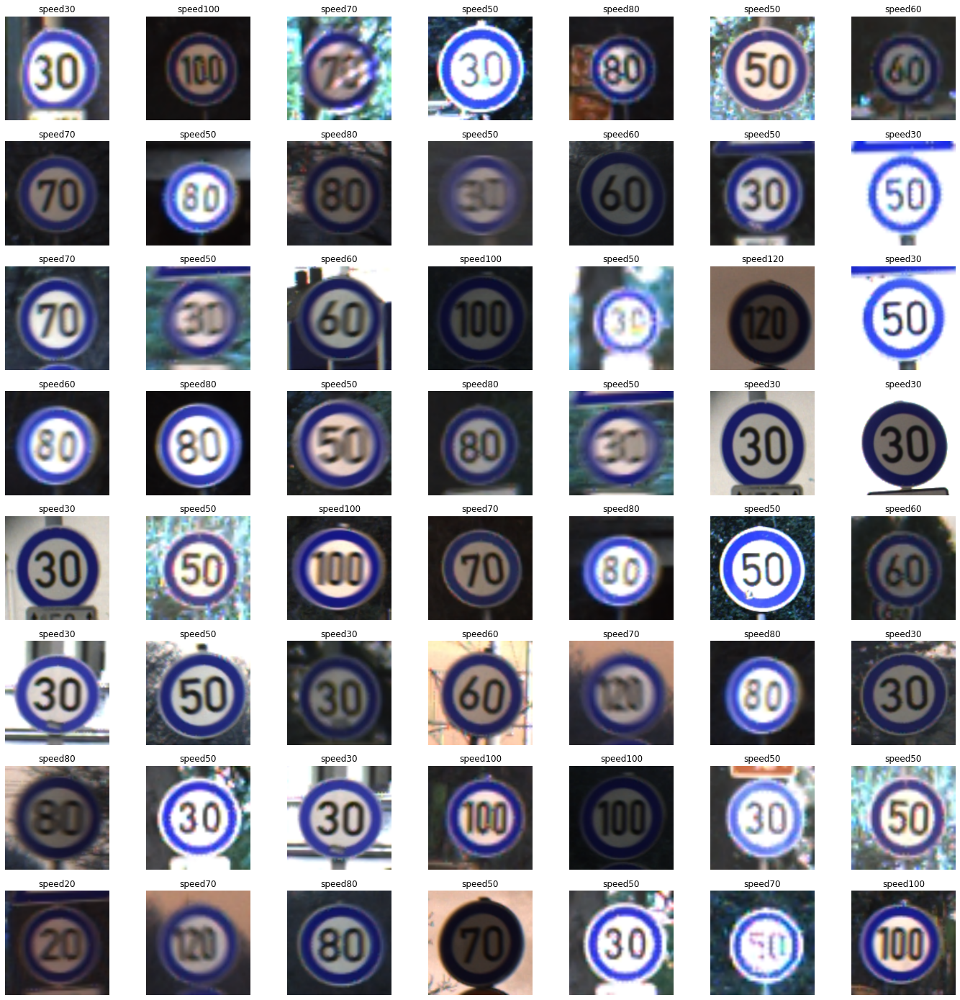

In [43]:
plt.figure(figsize=(24, 25))
for i in range(56):
    ax = plt.subplot(8, 7, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs_names[tools.most_frequent(Y_pred[i+booster])])
    plt.axis("off")
    plt.savefig('../reports/speed_model.png')

In [6]:
booster = 0

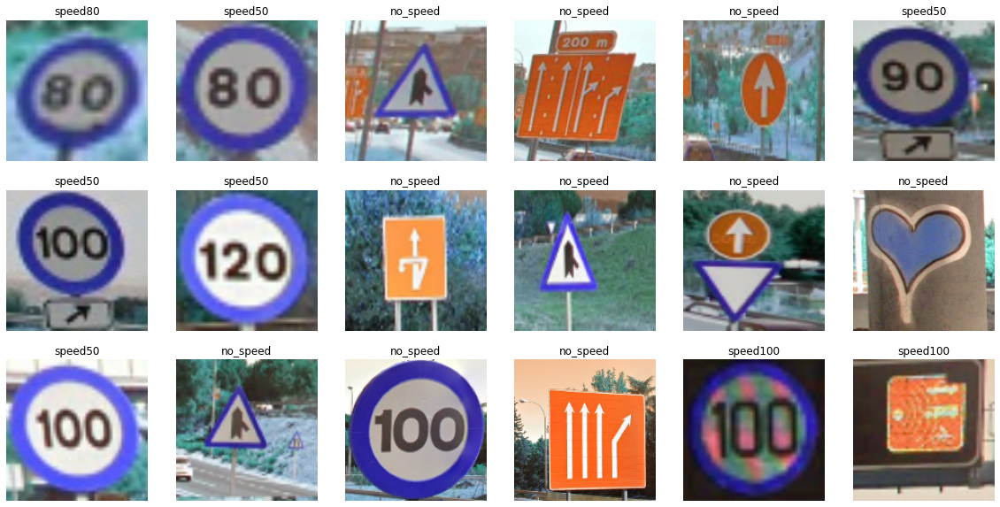

In [7]:
plt.figure(figsize=(20, 10))
for i in range(18):
    ax = plt.subplot(3, 6, i + 1)
    plt.imshow(img_list[i+booster])
    plt.title(signs[tools.most_frequent(Y_pred[i+booster])])
    plt.axis("off")
    plt.savefig('../reports/real_model.png')